In [186]:
import pandas as pd
import seaborn as sns
import plotly.express as px
import os
import numpy as np
import matplotlib.pyplot as plt

In [187]:
prices = pd.read_csv("/Users/ethan/Downloads/Germany Data/Day-ahead Prices_202201010000-202301010000.csv")
generation = pd.read_csv("/Users/ethan/Downloads/Germany Data/Actual Generation per Production Type_202201010000-202301010000.csv")
generation["Time"] = generation["Time"].apply(lambda x: x.strip())
load = pd.read_csv("/Users/ethan/Downloads/Germany Data/Total Load - Day Ahead _ Actual_202201010000-202301010000.csv")

/Users/ethan/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning:

Columns (23) have mixed types.Specify dtype option on import or set low_memory=False.



In [188]:
# merge the files based on day/time
df = pd.merge(prices, load, on="Time", how="left")
df = pd.merge(df, generation, on="Time", how="left")
df = df.dropna(subset=["Day-ahead Price [EUR/MWh]"])

df["price"] = df["Day-ahead Price [EUR/MWh]"].apply(float)
df["Day-ahead Total Load Forecast [MW] - BZN|DE-LU"] = df["Day-ahead Total Load Forecast [MW] - BZN|DE-LU"].apply(float) 
df["price"] = df["price"] + (-2 * np.min(df["price"]))
df["log price"] = np.log10(df["price"])

In [189]:
px.scatter(df, x="Day-ahead Total Load Forecast [MW] - BZN|DE-LU", y="log price", opacity=0.1)

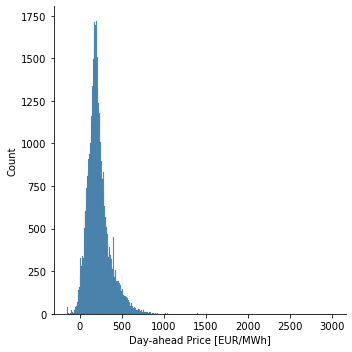

In [190]:
sns.displot(data=df, x="Day-ahead Price [EUR/MWh]")

In [191]:
px.line(df, y="price", x="Time")

In [192]:
df.tail

<bound method NDFrame.tail of                                       Time  Day-ahead Price [EUR/MWh]  \
0      01.01.2022 00:00 - 01.01.2022 00:15                      69.17   
1      01.01.2022 00:00 - 01.01.2022 00:15                      69.17   
2      01.01.2022 00:15 - 01.01.2022 00:30                      35.61   
3      01.01.2022 00:15 - 01.01.2022 00:30                      35.61   
4      01.01.2022 00:30 - 01.01.2022 00:45                      23.14   
...                                    ...                        ...   
46525  28.10.2022 22:45 - 28.10.2022 23:00                      72.84   
46526  28.10.2022 23:00 - 28.10.2022 23:15                      90.72   
46527  28.10.2022 23:15 - 28.10.2022 23:30                      88.57   
46528  28.10.2022 23:30 - 28.10.2022 23:45                     101.56   
46529  28.10.2022 23:45 - 29.10.2022 00:00                      91.35   

       Day-ahead Total Load Forecast [MW] - BZN|DE-LU  \
0                                   

## Data analysis for Germany

In [195]:
# start by iterating and reading in all of the files
price_data = []
country = "Germany"
for i in [2015, 2016, 2017, 2018, "2018a", 2019, 2020, 2021, 2022]:
        price_data.append(pd.read_csv(os.path.join("Data", country,"Prices_{}".format(i))))

prices = pd.concat(price_data)

# general clean up
prices = prices.dropna(subset=["Day-ahead Price [EUR/MWh]"])
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "n/e"]
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "-"]
prices["Price"] = prices["Day-ahead Price [EUR/MWh]"].apply(float)
prices = prices[["MTU (CET/CEST)","Price"]]

# convert the time range into a start + end time
prices["Start"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[0])
prices["End"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[1])

,MTU (CET/CEST),Price,Start,End
0,01.10.2015 00:00 - 01.10.2015 01:00,30.03,01.10.2015 00:00,01.10.2015 01:00
1,01.10.2015 01:00 - 01.10.2015 02:00,30.09,01.10.2015 01:00,01.10.2015 02:00
2,01.10.2015 02:00 - 01.10.2015 03:00,28.62,01.10.2015 02:00,01.10.2015 03:00
3,01.10.2015 03:00 - 01.10.2015 04:00,29.14,01.10.2015 03:00,01.10.2015 04:00
4,01.10.2015 04:00 - 01.10.2015 05:00,29.40,01.10.2015 04:00,01.10.2015 05:00
...,...,...,...,...
29183,31.10.2022 22:45 - 31.10.2022 23:00,73.10,31.10.2022 22:45,31.10.2022 23:00
29184,31.10.2022 23:00 - 31.10.2022 23:15,134.70,31.10.2022 23:00,31.10.2022 23:15
29185,31.10.2022 23:15 - 31.10.2022 23:30,95.87,31.10.2022 23:15,31.10.2022 23:30
29186,31.10.2022 23:30 - 31.10.2022 23:45,90.47,31.10.2022 23:30,31.10.2022 23:45


In [196]:
# work through the same process for the load data
load_data = []
country = "Germany"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        df = pd.read_csv(os.path.join("Data", country,"Load_{}".format(i)))
        load_data.append(df)

loads = pd.concat(load_data)
loads["Forecast"] = loads["Day-ahead Total Load Forecast [MW] - BZN|DE-AT-LU"].combine_first(loads["Day-ahead Total Load Forecast [MW] - BZN|DE-LU"])
loads["Actual"] = loads["Actual Total Load [MW] - BZN|DE-AT-LU"].combine_first(loads["Actual Total Load [MW] - BZN|DE-LU"])
loads = loads.dropna(subset=["Forecast", "Actual"])
loads = loads[loads["Actual"] != "n/e"]
loads = loads[loads["Actual"] != "-"]
loads["Actual"] = loads["Actual"].apply(float)
loads["Forecast"] = loads["Forecast"].apply(float)

loads = loads[["Time (CET/CEST)", "Forecast", "Actual"]]
# make the time range effective
loads["Start"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[0])
loads["End"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[1])

,Time (CET/CEST),Forecast,Actual,Start,End
0,01.01.2015 00:00 - 01.01.2015 00:15,50137.0,51439.0,01.01.2015 00:00,01.01.2015 00:15
1,01.01.2015 00:15 - 01.01.2015 00:30,49545.0,50988.0,01.01.2015 00:15,01.01.2015 00:30
2,01.01.2015 00:30 - 01.01.2015 00:45,49067.0,51059.0,01.01.2015 00:30,01.01.2015 00:45
3,01.01.2015 00:45 - 01.01.2015 01:00,48476.0,50882.0,01.01.2015 00:45,01.01.2015 01:00
4,01.01.2015 01:00 - 01.01.2015 01:15,47452.0,50467.0,01.01.2015 01:00,01.01.2015 01:15
...,...,...,...,...,...
28986,29.10.2022 22:30 - 29.10.2022 22:45,49222.0,45547.0,29.10.2022 22:30,29.10.2022 22:45
28987,29.10.2022 22:45 - 29.10.2022 23:00,48706.0,45329.0,29.10.2022 22:45,29.10.2022 23:00
28988,29.10.2022 23:00 - 29.10.2022 23:15,48045.0,44129.0,29.10.2022 23:00,29.10.2022 23:15
28989,29.10.2022 23:15 - 29.10.2022 23:30,47429.0,43542.0,29.10.2022 23:15,29.10.2022 23:30


In [200]:
#merge the two sets of data
merged = pd.merge(left = prices, right = loads, on = "Start", how="left")

### Plots

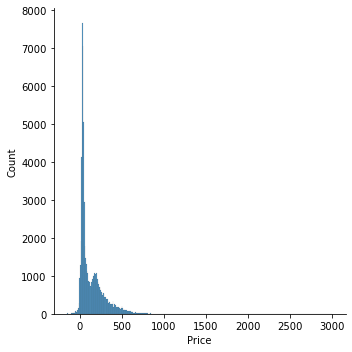

In [198]:
sns.displot(prices["Price"])

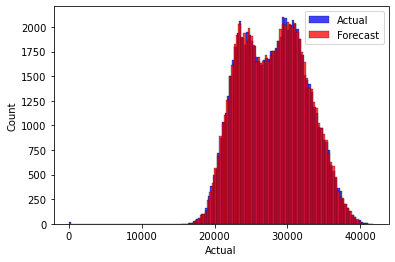

In [ ]:
sns.histplot(loads, x="Actual", color="blue", kde = False, label = "Actual")
sns.histplot(loads, x="Forecast", color = "red", kde = False, label = "Forecast")

plt.legend()
plt.show()

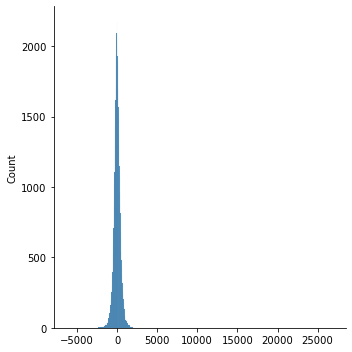

In [ ]:
sns.displot(loads["Forecast"]-loads["Actual"])

In [ ]:

# toss out the negative outliers
# merged = merged[merged.Price > 0]
merged["Log Price"] = np.log(merged["Price"] + 1)
px.scatter(merged, x = "Forecast", y="Log Price", opacity = 0.1, trendline="ols")


In [ ]:
px.scatter(merged, x = "Forecast", y = "Price", opacity = 0.1, trendline="ols")

## Spain

In [ ]:
price_data = []
country = "Spain"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        price_data.append(pd.read_csv(os.path.join("Data", country,"Prices_{}".format(i))))

prices = pd.concat(price_data)

# general clean up
prices = prices.dropna(subset=["Day-ahead Price [EUR/MWh]"])
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "n/e"]
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "-"]
prices["Price"] = prices["Day-ahead Price [EUR/MWh]"].apply(float)
prices = prices[["MTU (CET/CEST)","Price"]]

# convert the time range into a start + end time
prices["Start"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[0])
prices["End"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[1])


In [ ]:
# work through the same process for the load data
load_data = []
country = "Spain"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        df = pd.read_csv(os.path.join("Data", country,"Load_{}".format(i)))
        load_data.append(df)

loads = pd.concat(load_data)
loads["Forecast"] = loads["Day-ahead Total Load Forecast [MW] - BZN|ES"].combine_first(loads["Day-ahead Total Load Forecast [MW] - BZN|ES"])
loads["Actual"] = loads["Actual Total Load [MW] - BZN|ES"].combine_first(loads["Actual Total Load [MW] - BZN|ES"])
loads = loads.dropna(subset=["Forecast", "Actual"])
loads = loads[loads["Actual"] != "n/e"]
loads = loads[loads["Actual"] != "-"]
loads["Actual"] = loads["Actual"].apply(float)
loads["Forecast"] = loads["Forecast"].apply(float)

loads = loads[["Time (CET/CEST)", "Forecast", "Actual"]]
# make the time range effective
loads["Start"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[0])
loads["End"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[1])

In [ ]:
#merge the two sets of data
merged = pd.merge(left = prices, right = loads, on = "Start", how="left")

In [ ]:
sns.displot(prices["Price"])

In [ ]:
# toss out the negative outliers
# merged = merged[merged.Price > 0]
merged["Log Price"] = np.log(merged["Price"] + 1)
px.scatter(merged, x = "Forecast", y="Log Price", opacity = 0.1, trendline="ols")

In [ ]:
px.scatter(merged, x = "Forecast", y = "Price", opacity = 0.1, trendline="ols")

In [ ]:
sns.displot(loads["Forecast"]-loads["Actual"])

In [ ]:
sns.histplot(loads, x="Actual", color="blue", kde = False, label = "Actual")
sns.histplot(loads, x="Forecast", color = "red", kde = False, label = "Forecast")

plt.legend()
plt.show()

## The Netherlands

In [206]:
price_data = []
country = "Netherlands"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        price_data.append(pd.read_csv(os.path.join("Data", country,"Prices_{}".format(i))))

prices = pd.concat(price_data)

# general clean up
prices = prices.dropna(subset=["Day-ahead Price [EUR/MWh]"])
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "n/e"]
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "-"]
prices["Price"] = prices["Day-ahead Price [EUR/MWh]"].apply(float)
prices = prices[["MTU (CET/CEST)","Price"]]

# convert the time range into a start + end time
prices["Start"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[0])
prices["End"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[1])


In [207]:
# work through the same process for the load data
load_data = []
country = "Netherlands"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        df = pd.read_csv(os.path.join("Data", country,"Load_{}".format(i)))
        load_data.append(df)

loads = pd.concat(load_data)
loads["Forecast"] = loads["Day-ahead Total Load Forecast [MW] - BZN|NL"].combine_first(loads["Day-ahead Total Load Forecast [MW] - BZN|NL"])
loads["Actual"] = loads["Actual Total Load [MW] - BZN|NL"].combine_first(loads["Actual Total Load [MW] - BZN|NL"])
loads = loads.dropna(subset=["Forecast", "Actual"])
loads = loads[loads["Actual"] != "n/e"]
loads = loads[loads["Actual"] != "-"]
loads["Actual"] = loads["Actual"].apply(float)
loads["Forecast"] = loads["Forecast"].apply(float)

loads = loads[["Time (CET/CEST)", "Forecast", "Actual"]]
# make the time range effective
loads["Start"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[0])
loads["End"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[1])

In [208]:
#merge the two sets of data
merged = pd.merge(left = prices, right = loads, on = "Start", how="left")

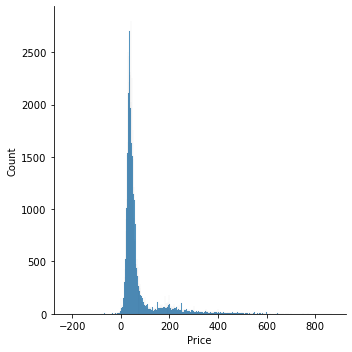

In [209]:
sns.displot(prices["Price"])

In [212]:
# toss out the negative outliers
merged = merged[merged.Price > 0]
merged["Log Price"] = np.log(merged["Price"] + 1)
px.scatter(merged, x = "Forecast", y="Log Price", opacity = 0.1, trendline="ols")

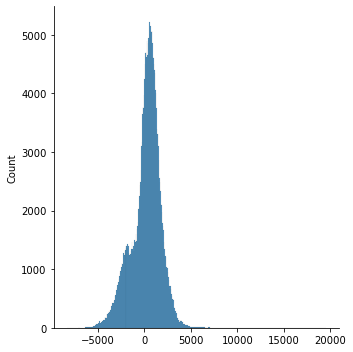

In [213]:
sns.displot(loads["Forecast"]-loads["Actual"])

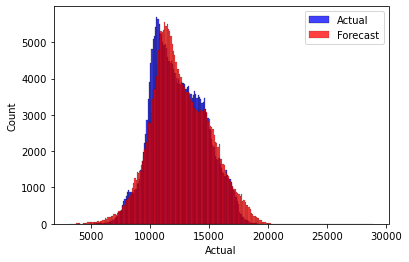

In [214]:
sns.histplot(loads, x="Actual", color="blue", kde = False, label = "Actual")
sns.histplot(loads, x="Forecast", color = "red", kde = False, label = "Forecast")

plt.legend()
plt.show()